### ESH

In [ ]:
# def esh(x0, f, k, epsilon, d=2):
#     """Run esh for k steps, with step size epsilon"""
#     v = onp.random.randn(*x0.shape)  # Not the correct way to get randoms in JAX
#     g = jax.grad(f)  # Gradient of energy function
#     x = x0  # save the original state, in case we reject the update
#     for i in range(k):
#         v = v - 0.5 * epsilon * g(x)  # half step in v
#         x = x + epsilon * (v / (v**2 / d))  # full step in x
#         v = v - 0.5 * epsilon * g(x)  # half step in v  
#         # more efficient to combine half-steps
#     if onp.random.random() > np.exp(f(x0) - f(x)):
#         # print("Metropolis- Hastings REJECT", f(x0), f(x))
#         x = x0
#     return x

def esh(x, v, f, epsilon, d=2):
    """Start with position, x, velocity, v, energy, f, step size, epsilon
    And integrate for one step with leapfrog."""
    g = jax.grad(f)
    vp = v - 0.5 * epsilon * g(x)  # half step in v
    xp = x + epsilon * (vp / (vp**2 / d))  # full step in x
    vpp = vp - 0.5 * epsilon * g(xp)  # half step in v
    return xp, vpp

In [ ]:
potential = energy_fn
d = 2  # dimensionality 
n_iter = 200
v = 10

epsilon = 5
# x = random.normal(key, (d,))  # x, position
# x = random.uniform(key, (d,), minval=0, maxval=550)
x = np.array((1000., 1000.))
print(x)
trajectories = onp.zeros((1, n_iter, 2), dtype=x.dtype)  

for i in tqdm(range(n_iter)):
    x, v = esh(x, v, potential, epsilon)
    trajectories[0,i] = x

[1000. 1000.]


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 200/200 [00:26<00:00,  7.51it/s]


In [ ]:
# Visualize trajectories
ani4 = viz_trajectories(trajectories, decay=0.95, image=density)
ani4  # Show it

Formatting data...
Creating animation...


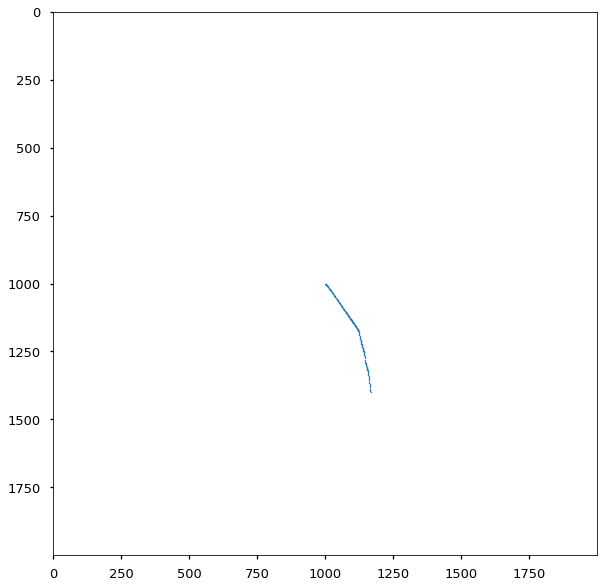

In [ ]:
# Plot samples
# (scatter) plot the samples with image in background
samples = trajectories[0]
fig = matplotlib.pyplot.figure(figsize=(10, 10))
ax = fig.add_subplot(1, 1, 1)
ax.scatter(onp.array(samples)[:, 1], onp.array(samples)[:, 0], s=1, alpha=1)
ax.imshow(density, alpha=0.0)
matplotlib.pyplot.show()
fig.savefig(f"{result_folder}/{image_name}_esh_sampled.png")